In [96]:
using Plots, LinearAlgebra, Distributions

In [119]:
N = 1000
truncN = (m, s) -> truncated(Normal(m, s), lower = 0)
m1, m2, r = rand(truncN(1000000000000000000000, 10000), N), rand(truncN(1000000000000000000000, 100000), N), rand(truncN(1000000000000000, 10000), N)
F = ((6.67 * 10^-11) * (m1 .* m2 ./ (r .^ 2)))

1000-element Vector{Float64}:
 66.6999999986836
 66.70000000124945
 66.69999999794801
 66.70000000053146
 66.70000000076895
 66.70000000037905
 66.70000000026543
 66.69999999921693
 66.7000000026823
 66.69999999971019
 66.6999999996458
 66.69999999979234
 66.69999999894007
  ⋮
 66.7000000022254
 66.69999999943285
 66.6999999987439
 66.7000000002538
 66.70000000259328
 66.6999999986314
 66.70000000074792
 66.6999999991257
 66.70000000047553
 66.70000000033767
 66.69999999960945
 66.70000000156381

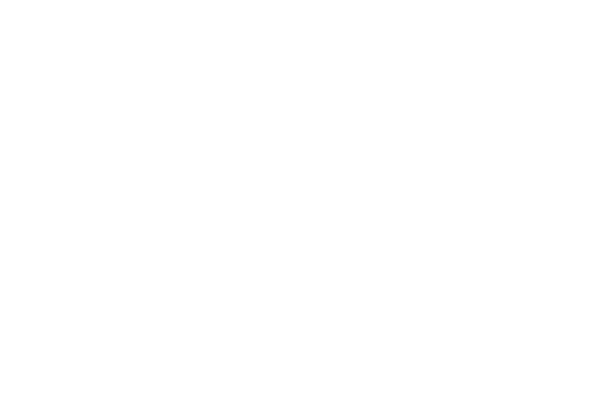

In [121]:
scatter(m1, F, legend = false)

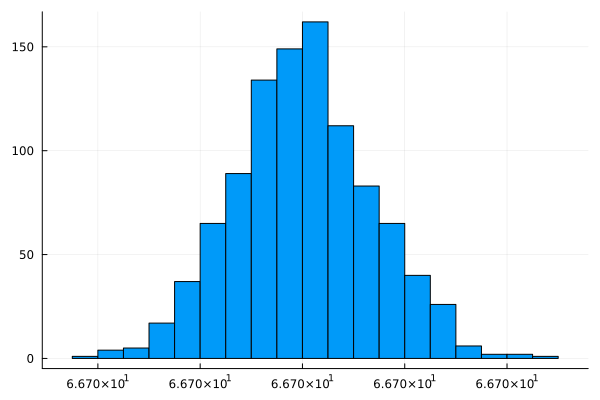

GKS: Possible loss of precision in routine SET_WINDOW


In [122]:
histogram(F, legend = false)

In [123]:
l = @layout [a b; c d]
m1h, m2h, rh, Fh = histogram(m1, legend = false, title = "m1") , histogram(m2, legend = false, title = "m2"), histogram(r, legend = false, title = "r"), histogram(F, legend = false, title = "F")
plot(m1h, m2h, rh, Fh, layout = l)

In [101]:
X = [ones(N) m1 m2 r]
Y = F
w = inv(X' * X) * X' * Y
w, (X * w - Y)' * (X * w - Y)

([1.0703812303015364e-11, 2.6739032071837857e-14, 2.667993891781464e-14, -2.1396092514097912e-14], 1.1178210151926633e-25)

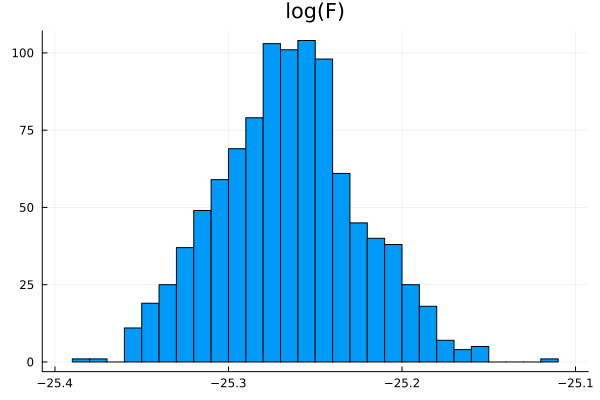

In [102]:
histogram(log.(F), legend = false, title = "log(F)")

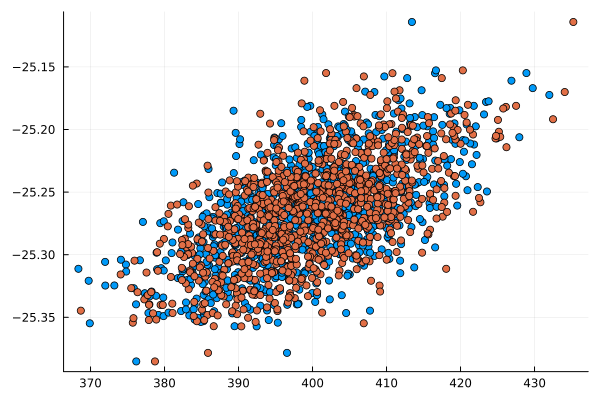

In [103]:
scatter(m1, log.(F), legend = false); scatter!(m2, log.(F), legend = false) #

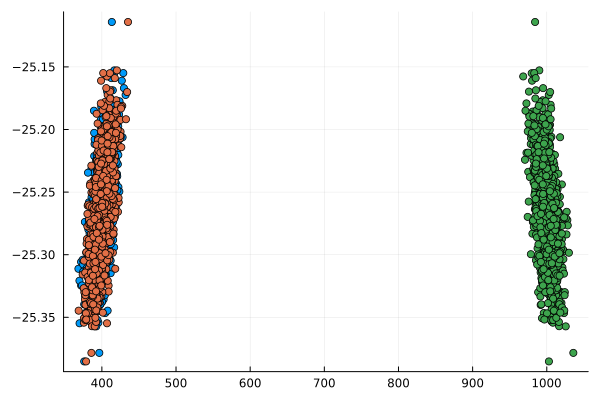

In [104]:
scatter!(r, log.(F), legend = false)

In [105]:
X = [ones(N) m1 m2 r]
Y = log.(F)
w = inv(X' * X) * X' * Y
w, (X * w - Y)' * (X * w - Y)

([-25.265446306730155, 0.0025045561364152036, 0.0024981209957162243, -0.0019995346993084695], 0.00040881099008522063)

In [114]:
(exp.(X * w) - exp.(Y)) .^ 2 |> sum

4.7182047282200685e-26